## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## Init Notebook

In [2]:
import numpy as np
import scipy as sp
import cv2
import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from moviepy.editor import VideoFileClip
from IPython.display import HTML

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

%matplotlib inline
%config InlineBackend.figure_formats = {'png', 'retina'}
matplotlib.rcParams['figure.figsize'] = (15.0, 8.0)
plt.rcParams.update({'font.size': 18})

## Helper Functions

In [43]:
def plot_side_by_side(img1, img2, title1, title2, hlines=False, save_path1=None, save_path2=None):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img1)
    ax1.set_title(title1, fontsize=40)

    ax2.imshow(img2)
    ax2.set_title(title2, fontsize=40)
    if hlines:
        for y in range(0, img2.shape[0], 50):
            ax2.axhline(y=y, xmin=0.0, xmax=1.0, color='grey')

    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    if save_path1 is not None:
        cv2.imwrite(save_path1, cv2.cvtColor(img1, cv2.COLOR_RGB2BGR))
    if save_path2 is not None:
        cv2.imwrite(save_path2, cv2.cvtColor(img2, cv2.COLOR_RGB2BGR))

## Find Chessboard Corners in Calibration Images

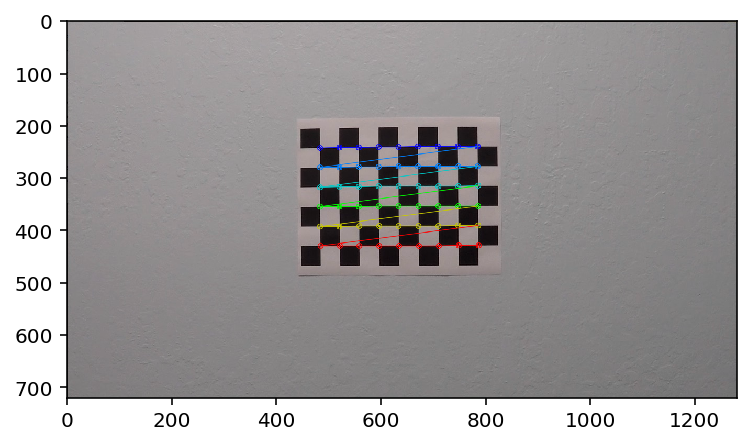

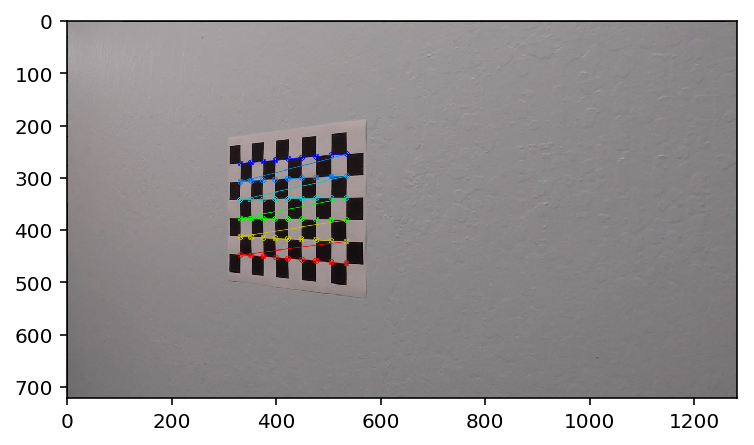

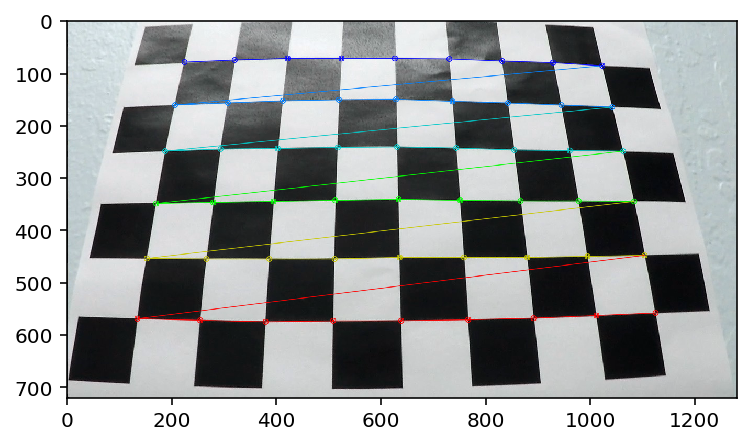

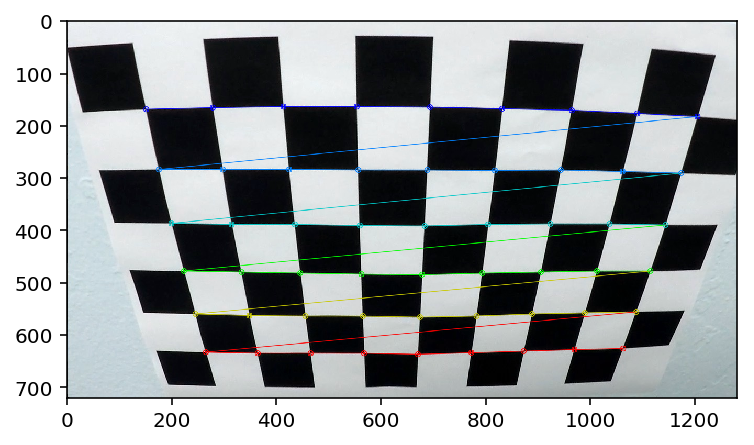

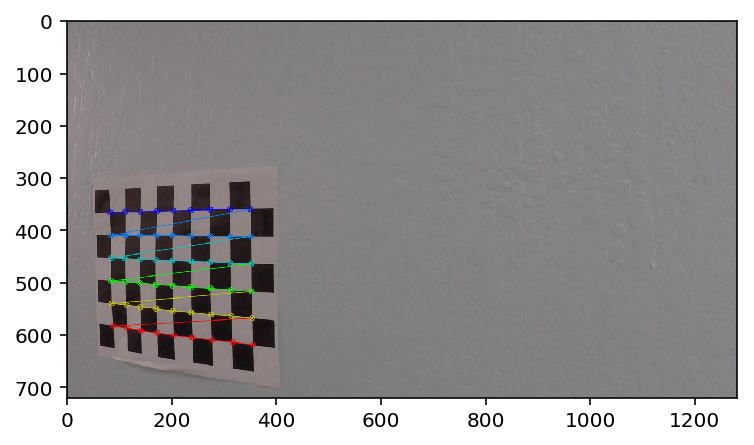

...

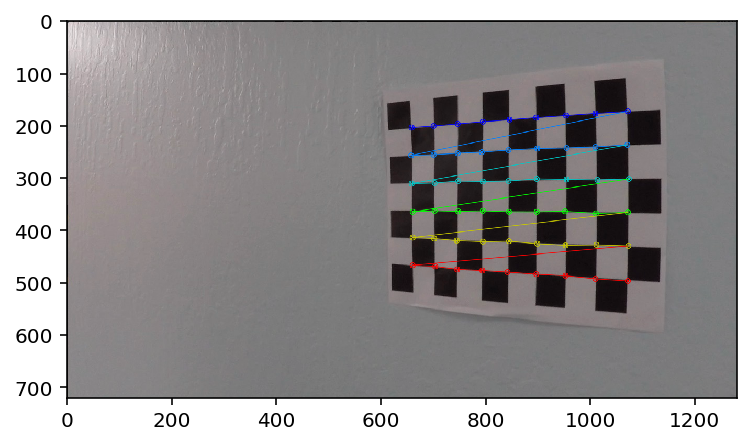

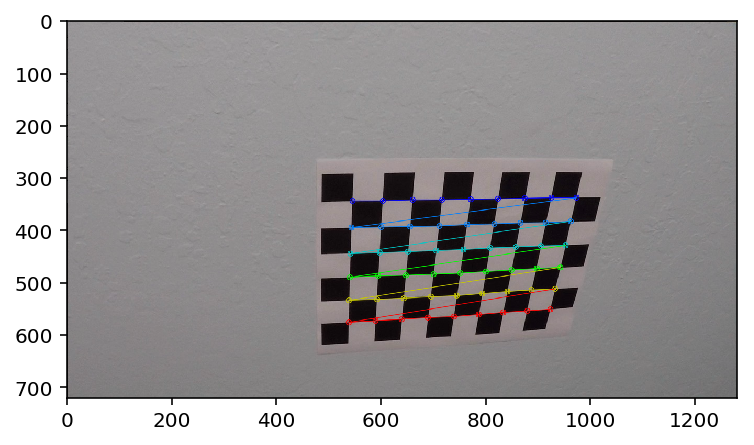

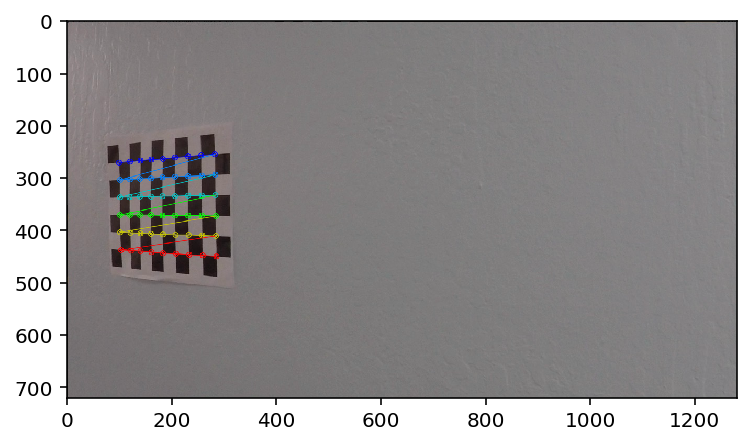

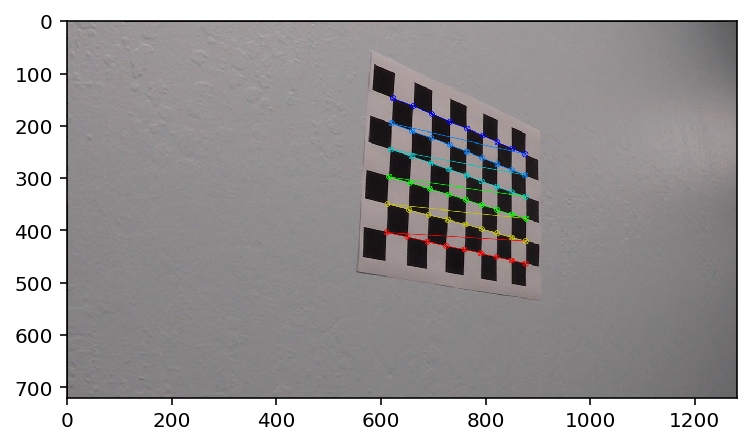

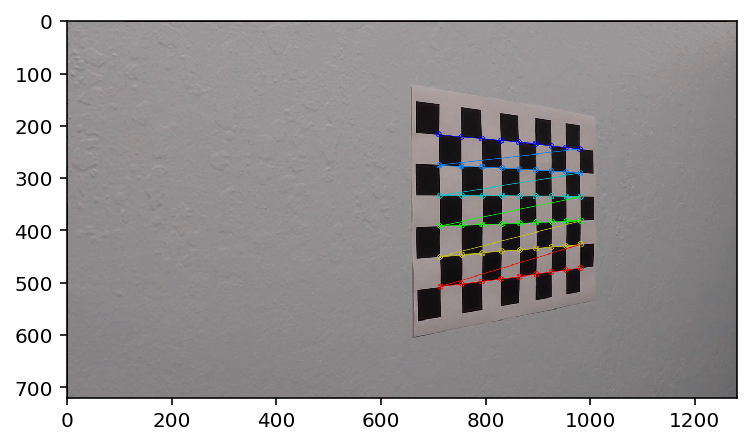

Found chessboard corners in 17 out of 20 images.


In [33]:
# Draw successfully found corners:
draw_corners = True

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

successful_images = 0
# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        successful_images += 1
        
        if draw_corners:
            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
            plt.imshow(img)
            cv2.imwrite("output_images/chessboard_{0}.jpg".format(successful_images), img)
            plt.show()

print("Found chessboard corners in {0} out of {1} images.".format(successful_images, len(images)))

## Calibrate Camera

In [5]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

def undistort(img):
    return cv2.undistort(img, mtx, dist, None, mtx)

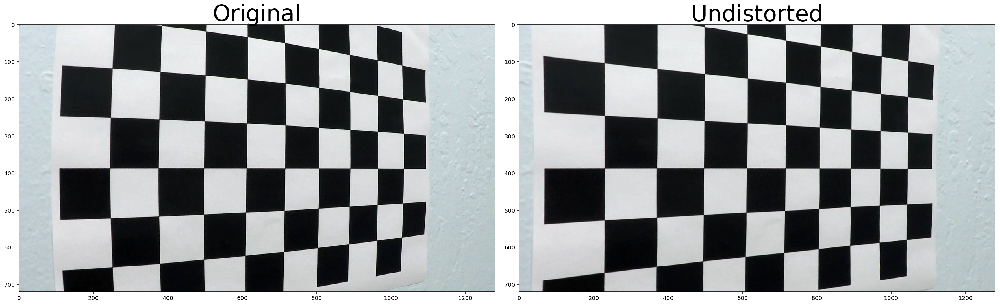

In [36]:
# Test undistortion:
images = glob.glob('camera_cal/calibration*.jpg')
img = cv2.imread(images[0])

u_img = undistort(img)

plot_side_by_side(img, u_img, "Original", "Undistorted", save_path1="output_images/chess_before.jpg", save_path2="output_images/chess_after.jpg")

## Perspective Transform

In [38]:
src = np.array([[[185, 720], [594, 450], [684, 450], [1100, 720]]], dtype='float32')
dst = np.array([[[300, 720], [300, 0], [980, 0], [980, 720]]], dtype='float32')

def draw_polygon_outline(img, polygon=src):
    output = np.copy(img)
    polygon_color = (255, 0, 0)
    polygon_int = polygon.astype('int32')
    cv2.polylines(output, polygon_int, True, polygon_color, thickness=2)
    return output

def transform_perspective(img, draw_polygon=False):
    img_size = (img.shape[1], img.shape[0])
    
    M = cv2.getPerspectiveTransform(src, dst)
    transformed = cv2.warpPerspective(img, M, img_size)
    if draw_polygon:
        transformed = draw_polygon_outline(transformed, dst)

    return transformed

def inverse_perspective_transform(img):
    img_size = (img.shape[1], img.shape[0])
    Minv = cv2.getPerspectiveTransform(dst, src)
    transformed = cv2.warpPerspective(img, Minv, img_size)
    return transformed

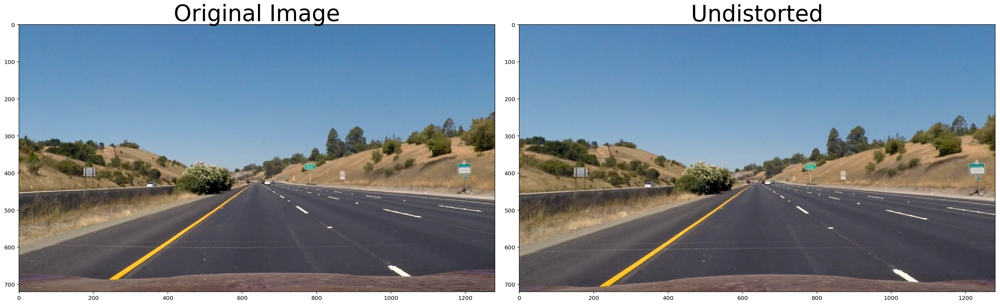

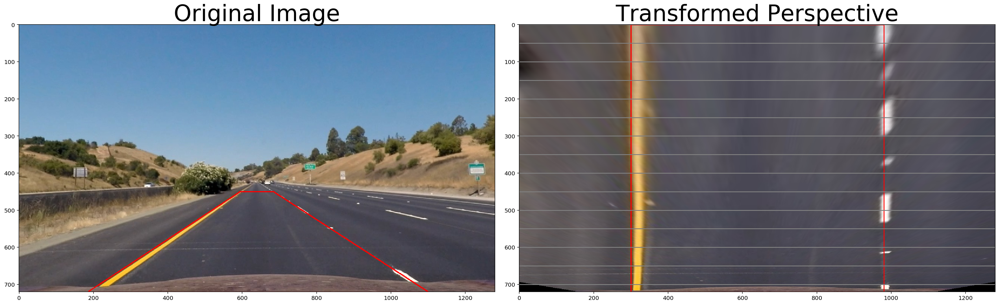

In [68]:
# Test perspective transform
images = glob.glob('test_images/*.jpg')
for fname in images[-1:]:
    img = mpimg.imread(fname)
    
    undistorted = undistort(img)
    plot_side_by_side(img, undistorted, "Original Image", "Undistorted", save_path1="output_images/undistort_before.jpg", save_path2="output_images/undistort_after.jpg")


    img_poly = draw_polygon_outline(undistorted)
    img_transformed = transform_perspective(undistorted, draw_polygon=True)

    plot_side_by_side(img_poly, img_transformed, "Original Image", "Transformed Perspective", hlines=True, save_path1="output_images/persp_before.jpg", save_path2="output_images/persp_after.jpg")



## Edge Detection

In [45]:
# Create a mask from three separate thresholds for the different channels
def _channel_thresholding(img, first_thresh=(0, 255), second_thresh=(40, 255), third_thresh=(100, 255), debug=False):
    # Helper function to threshold a single channel with thresholds defined as tuple:
    def threshold_channel(channel, threshold):
        binary = np.zeros_like(channel)
        binary[(channel >= threshold[0]) & (channel <= threshold[1])] = 1
        return binary
       
    first_binary = threshold_channel(img[:,:,0], first_thresh)
    second_binary = threshold_channel(img[:,:,1], second_thresh)
    third_binary = threshold_channel(img[:,:,2], third_thresh)
    
    mask = np.zeros_like(first_binary)
    mask[(first_binary ==1) & (second_binary == 1) & (third_binary == 1)] = 1
    
    if debug:
        plt.imshow(first_binary, cmap='Greys')
        plt.show()
        plt.imshow(second_binary, cmap='Greys')
        plt.show()
        plt.imshow(third_binary, cmap='Greys')
        plt.show()
        plt.imshow(mask, cmap='Greys')
        plt.show()
    
    return mask

def _find_double_peaks(img, peak_separation=70, min_peak_width = 5, peak_threshold=0.15):
    # A line on asphalt will have a strong positive x-derivative followed by a strong negative one.
    # This function attempts to identify those situations and avoid detecting one-sided transitions such as those from larger shadows
    img_width = img.shape[1]
    img_height = img.shape[0]
    peak_max = np.max(np.absolute(img))
    peak_thresh = int(peak_threshold * peak_max)
    
    double_peak_mask = np.zeros_like(img)

    for y in range(img_height):
        pos_peak = None
        pos_peak_counter = 0
        neg_peak_counter = 0
        for x in range(peak_separation, img_width - peak_separation):
            if pos_peak is not None and x - pos_peak > peak_separation: # We have found a peak but it is now too far back
                pos_peak = None # Reset peak index
                pos_peak_counter = 0
                neg_peak_counter = 0
            elif pos_peak is None: # We haven't found a positive peak yet or we are still on a peak
                if img[y, x] >= peak_thresh: # We are on a peak
                    pos_peak_counter += 1
                    if pos_peak_counter >= min_peak_width: # On a peak of sufficient width
                        pos_peak = x # remember pos peak index
                else:
                    pos_peak_counter = 0 # Not on a positive peak, reset index       
            else: # We have found a positive peak and its within the peak_separation ago:
                if img[y, x] <= -peak_thresh: # This is a negative peak
                    neg_peak_counter += 1
                    if neg_peak_counter >= min_peak_width: # On a peak of sufficient width
                        double_peak_mask[y, pos_peak : x + min_peak_width] = 1
                        pos_peak = None # Reset peak index
                        pos_peak_counter = 0
                        neg_peak_counter = 0


    return np.uint8(double_peak_mask)


def _sobel_x_double_peaks(channel, peak_separation=70, min_peak_width=5, peak_threshold=0.15):
    # Sobel x
    sobelx = cv2.Sobel(channel, cv2.CV_64F, 1, 0, ksize=7) # Take the derivative in x
    double_peak_mask = _find_double_peaks(sobelx, peak_separation=peak_separation, min_peak_width=min_peak_width, peak_threshold=peak_threshold)
    #output = _erode_and_dilate(double_peak_mask, erosion_iterations=1, dilation_iterations=1)
    return double_peak_mask

def _sobel_x_thresholding(l_channel, thresh=(0, 255)):
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=1) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return sxbinary

def _erode_and_dilate(img, erosion_iterations=1, dilation_iterations=1):
    if erosion_iterations != 0:
        erosion_kernel = np.ones((3, 3), np.uint8)
        img = cv2.erode(img, erosion_kernel, iterations=erosion_iterations)
    if dilation_iterations != 0:
        dilation_kernel = np.ones((3, 3), np.uint8)
        #img = cv2.GaussianBlur(img, (gaussian_kernel, gaussian_kernel), 0)
        img = cv2.dilate(img, dilation_kernel, iterations=1)
    return img

def detect_edges(img, stacked=False):
    img = np.copy(img)
    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    luv = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    
    # Get a binary mask based on channel thresholds:
    white_channel_mask = _channel_thresholding(luv, first_thresh=(220, 255), second_thresh=(0, 255), third_thresh=(0, 255))
    yellow_channel_mask = _channel_thresholding(hls, first_thresh=(22, 80), second_thresh=(30, 180), third_thresh=(40, 255))
    yellow_channel_mask = _erode_and_dilate(yellow_channel_mask, erosion_iterations=1, dilation_iterations=1)
    b_channel_mask = _channel_thresholding(lab, first_thresh=(0, 225), second_thresh=(0, 225), third_thresh=(150, 220))
    
    # Get a binary mask based on lightness x derivative:
    #lightness_sobel_mask = np.zeros_like(b_channel_mask)
    lightness_sobel_mask =_sobel_x_double_peaks(hls[:,:,1], peak_separation=50, min_peak_width=10, peak_threshold=0.15)    
    blue_sobel_mask = _sobel_x_double_peaks(img[:,:,2], peak_separation=50, min_peak_width=10, peak_threshold=0.12)
    #blue_sobel_mask = _erode_and_dilate(blue_sobel_mask, erosion_iterations=1, dilation_iterations=1)
    
    # Stack channels
    if stacked:
        color_binary = np.dstack((lightness_sobel_mask, b_channel_mask, white_channel_mask)) * 255
        return color_binary
    else:
        mask = np.zeros_like(white_channel_mask)
        mask[(white_channel_mask == 1) | (yellow_channel_mask == 1) | (lightness_sobel_mask == 1) | (blue_sobel_mask == 1) | (b_channel_mask == 1)] = 1
        return mask


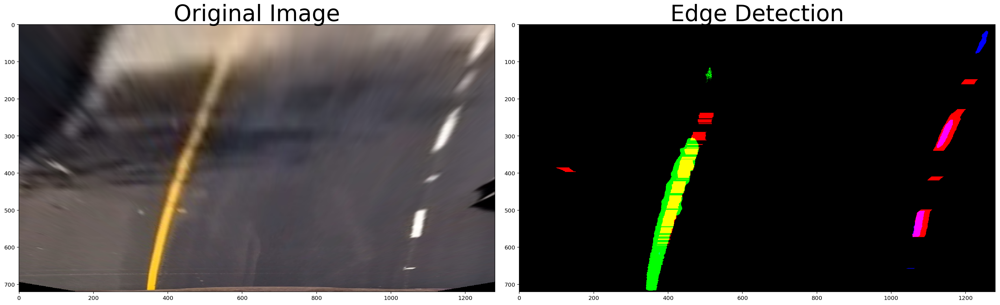

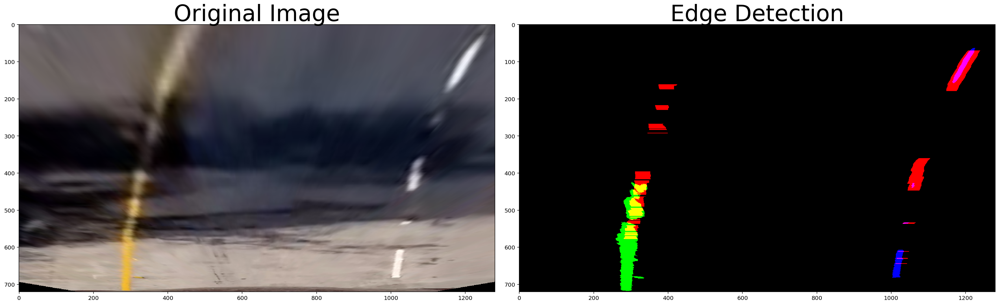

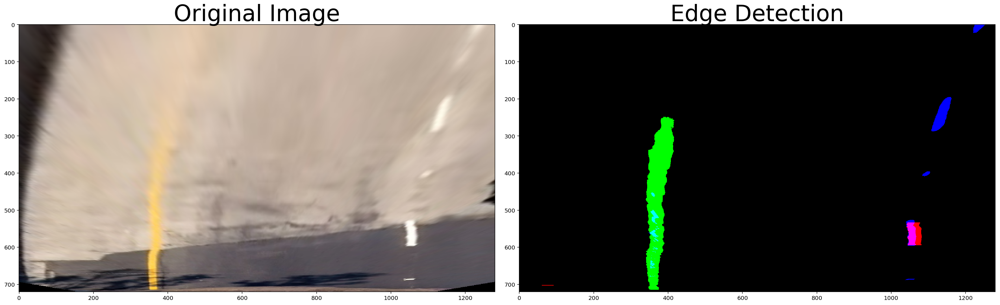

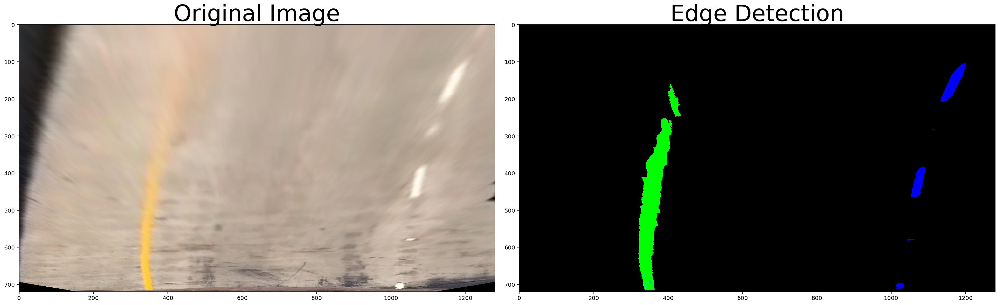

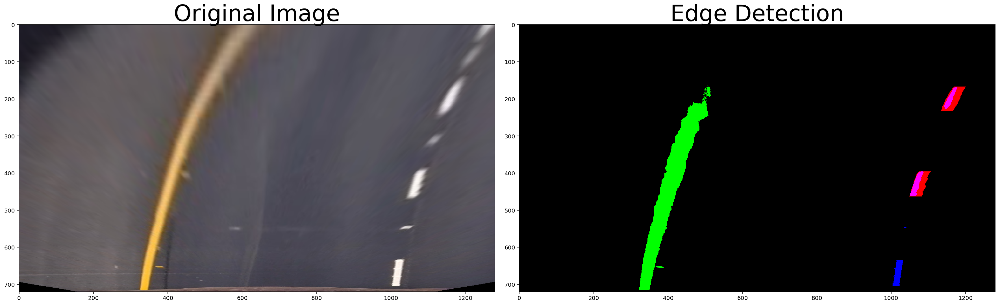

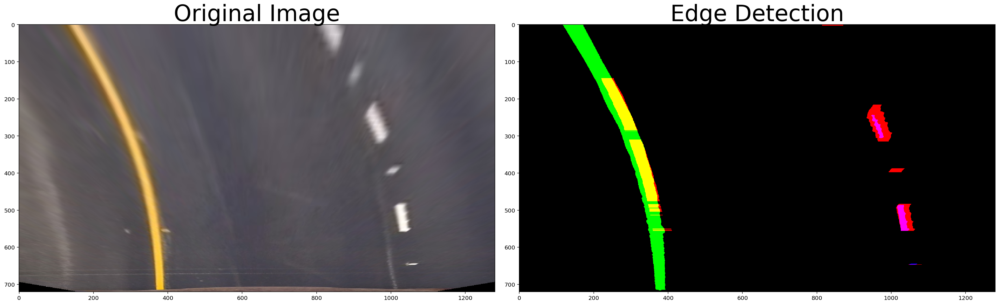

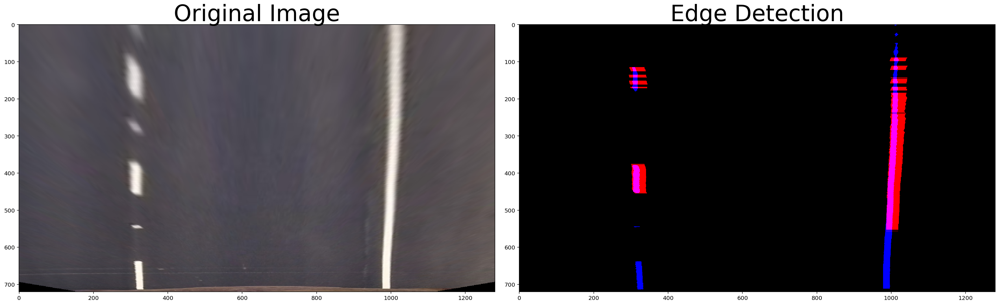

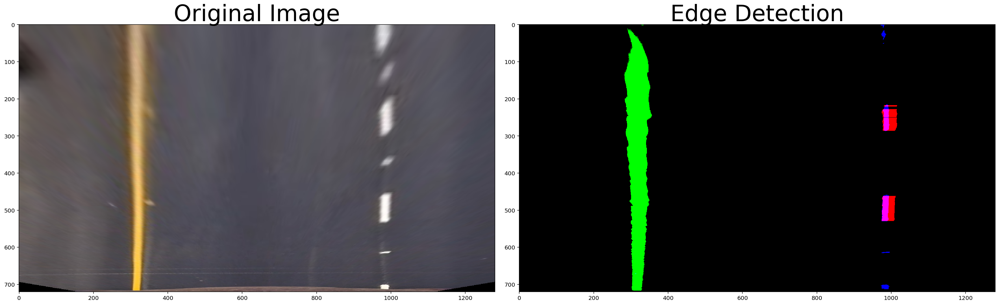

In [46]:
# Test edge detection
images = glob.glob('test_images/*.jpg')
for i, fname in enumerate(images):
    img = mpimg.imread(fname)
    undistorted = undistort(img)
    img_transformed = transform_perspective(undistorted, draw_polygon=False)
    
    result = detect_edges(img_transformed, stacked=True)

    plot_side_by_side(img_transformed, result, "Original Image", "Edge Detection", save_path1="output_images/edge_before{0}.jpg".format(i), save_path2="output_images/edge_after{0}.jpg".format(i))


## Find Lane Pixels and Estimate Polynomial

In [58]:
def _get_starting_centroid(img, window, window_width):
    lower_quarter = int(3*img.shape[0]/4)
    half_width = int(img.shape[1]/2)
    
    # Sum vertical pixel lines of bottom qurter of the image:
    l_sum = np.sum(img[lower_quarter:, :half_width], axis=0)
    l_center = np.argmax(np.convolve(window, l_sum)) - window_width/2
    
    r_sum = np.sum(img[lower_quarter:, half_width:], axis=0)
    r_center = np.argmax(np.convolve(window, r_sum)) - window_width/2 + half_width
    
    return l_center, r_center

def _find_window_centroids(img, window_width, window_height, margin):
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Find and add starting points:
    l_center, r_center = _get_starting_centroid(img, window, window_width)
    window_centroids.append((l_center,r_center))
    
    img_height = img.shape[0]
    img_width = img.shape[1]
    num_windows = (int)(img_height / window_height)
    
    # Go through each layer looking for max pixel locations
    for level in range(1, num_windows):
        # convolve the window into the vertical slice of the image
        window_upper_y = int(img_height - (level+1) * window_height)
        window_lower_y = int(img_height -  level    * window_height)
        
        image_layer = np.sum(img[window_upper_y : window_lower_y, :], axis=0)
        conv_signal = np.convolve(window, image_layer)
        
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center + offset - margin, 0))
        l_max_index = int(min(l_center + offset + margin, img_width))
        l_conv = conv_signal[l_min_index:l_max_index]
        if sum(l_conv) > 0: # Only update if there are actual pixels present in window
            l_center = np.argmax(l_conv) + l_min_index - offset
        
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center + offset - margin, 0))
        r_max_index = int(min(r_center + offset + margin, img_width))
        r_conv = conv_signal[r_min_index:r_max_index]
        if sum(r_conv) > 0:  # Only update if there are actual pixels present in window
            r_center = np.argmax(r_conv) + r_min_index - offset
        
        # Add what we found for that layer
        window_centroids.append((l_center, r_center))

    return window_centroids

def _get_window_indices(img_shape, width, height, center, level):
    y1 = int(img_shape[0] - (level+1) * height)
    y2 = int(img_shape[0] -  level    * height)
    x1 = max(0, int(center - width/2))
    x2 = min(   int(center + width/2), img_shape[1])
    return y1, y2, x1, x2

def _window_mask(width, height, img_ref, center, level):
    output = np.zeros_like(img_ref)
    y1, y2, x1, x2 = _get_window_indices(img_ref.shape, width, height, center, level)
    output[y1:y2, x1:x2] = 1
    return output

def get_nonzero_pixels_one_line(img, window_centroids, window_width, window_height, left_side=True):
    lane_x = []
    lane_y = []
    
    for level, centroids in enumerate(window_centroids):
        center_left, center_right = centroids
        if left_side:
            y1_left, y2_left, x1_left, x2_left = _get_window_indices(img.shape, window_width, window_height, center_left, level)
            nonzero_left = img[y1_left:y2_left, x1_left:x2_left].nonzero()
            lane_x += list(nonzero_left[1] + x1_left)
            lane_y += list(nonzero_left[0] + y1_left)
        else:
            y1_right, y2_right, x1_right, x2_right = _get_window_indices(img.shape, window_width, window_height, center_right, level)
            nonzero_right = img[y1_right:y2_right, x1_right:x2_right].nonzero()
            lane_x += list(nonzero_right[1] + x1_right)
            lane_y += list(nonzero_right[0] + y1_right)

    return np.array(lane_x), np.array(lane_y)

def _get_nonzero_pixels(img, window_centroids, window_width, window_height):
    left_lane_x = []
    right_lane_x = []
    left_lane_y = []
    right_lane_y = []
    
    for level, centroids in enumerate(window_centroids):
        center_left, center_right = centroids
        
        y1_left, y2_left, x1_left, x2_left = _get_window_indices(img.shape, window_width, window_height, center_left, level)
        nonzero_left = img[y1_left:y2_left, x1_left:x2_left].nonzero()
        left_lane_x += list(nonzero_left[1] + x1_left)
        left_lane_y += list(nonzero_left[0] + y1_left)

        y1_right, y2_right, x1_right, x2_right = _get_window_indices(img.shape, window_width, window_height, center_right, level)
        nonzero_right = img[y1_right:y2_right, x1_right:x2_right].nonzero()
        right_lane_x += list(nonzero_right[1] + x1_right)
        right_lane_y += list(nonzero_right[0] + y1_right)

    return np.array(left_lane_x), np.array(left_lane_y), np.array(right_lane_x), np.array(right_lane_y)

def get_nonzero_pixels_from_priors_one_line(img, margin, fit, left_side=True):
    #half_width = int(img.shape[1]/2)
    #img_cp = np.copy(img)
    #if left_side:
    #    img_cp[:, :half_width] = 0
    #else:
    #    img_cp[:, half_width:] = 0
        
    nonzero = img.nonzero()

    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    lane_inds = ((nonzerox > (fit[0]*(nonzeroy**2) + fit[1]*nonzeroy +fit[2] - margin)) &
                 (nonzerox < (fit[0]*(nonzeroy**2) + fit[1]*nonzeroy + fit[2] + margin)))
    
    x = nonzerox[lane_inds]
    y = nonzeroy[lane_inds]
    
    return x, y

def _get_nonzero_pixels_from_priors(img, margin, left_fit, right_fit):
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    left_lane_x = nonzerox[left_lane_inds]
    left_lane_y = nonzeroy[left_lane_inds] 
    right_lane_x = nonzerox[right_lane_inds]
    right_lane_y = nonzeroy[right_lane_inds]
    
    return left_lane_x, left_lane_y, right_lane_x, right_lane_y

def visualize_centroids(window_centroids, img, window_width, window_height):
    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(img)
        r_points = np.zeros_like(img)

        # Go through each level and draw the windows 
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = _window_mask(window_width, window_height, img, window_centroids[level][0], level)
            r_mask = _window_mask(window_width, window_height, img, window_centroids[level][1], level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage= np.dstack((img, img, img))*255 # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((img,img,img)),np.uint8)

    # Display the final results
    plt.imshow(output)

def visualize_prior_polygon(img, left_fit, right_fit, leftx, lefty, rightx, righty, margin):
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((img, img, img))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    if left_fit is not None:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    if right_fit is not None:
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]    
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    plt.imshow(result)
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='red')
    plt.plot(right_fitx, ploty, color='red')
    
    
def _plot_fitted_lines(left_fit, right_fit, img_shape):
    # Plots the left and right polynomials on the lane lines
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    if left_fit is not None:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        plt.plot(left_fitx, ploty, color='yellow')
    if right_fit is not None:
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        plt.plot(right_fitx, ploty, color='yellow')

    
def fit_lane_polynomials(img, leftx, lefty, rightx, righty, visualize=False, rescale=False):
    # Fit a second order polynomial to each using `np.polyfit`
    if rescale:
        xm_per_pix, ym_per_pix = estimate_pixel_scale()
        left_fit = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2) if len(leftx) > 0 else None
        right_fit = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2) if len(rightx) > 0 else None
    else:
        left_fit = np.polyfit(lefty, leftx, 2) if len(leftx) > 0 else None
        right_fit = np.polyfit(righty, rightx, 2) if len(rightx) > 0 else None

    if not visualize:
        return left_fit, right_fit, None
    else:
        # Colors in the left and right lane regions
        out_img = np.dstack((img, img, img))*255
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]
        plt.imshow(out_img)
        
        _plot_fitted_lines(left_fit, right_fit, img.shape)
            
        return left_fit, right_fit, out_img        

def get_lane_polynomials(img, window_width, window_height, margin, visualize=False, rescale=False):
    window_centroids = _find_window_centroids(img, window_width, window_height, margin)
    if visualize:
        visualize_centroids(window_centroids, img, window_width, window_height)
        plt.savefig("output_images/pixel_windows.png", bbox_inches="tight")
        plt.show()
        
    leftx, lefty, rightx, righty = _get_nonzero_pixels(img, window_centroids, window_width, window_height)
    left_fit, right_fit, out_img = fit_lane_polynomials(img, leftx, lefty, rightx, righty, visualize=visualize, rescale=rescale)
    
    return left_fit, right_fit
    
def get_lane_polynomials_from_priors(img, window_width, window_height, margin, left_fit, right_fit, visualize=False, rescale=False):
    leftx, lefty, rightx, righty = _get_nonzero_pixels_from_priors(img, margin, left_fit, right_fit)
    if visualize:
        visualize_prior_polygon(img, left_fit, right_fit, leftx, lefty, rightx, righty, margin)
    left_fit, right_fit, out_img = fit_lane_polynomials(img, leftx, lefty, rightx, righty, visualize=False, rescale=rescale)
    
    return left_fit, right_fit

def estimate_pixel_scale():
    xm_per_pix = 3.7/660
    ym_per_pix = 3.0/60

    return xm_per_pix, ym_per_pix

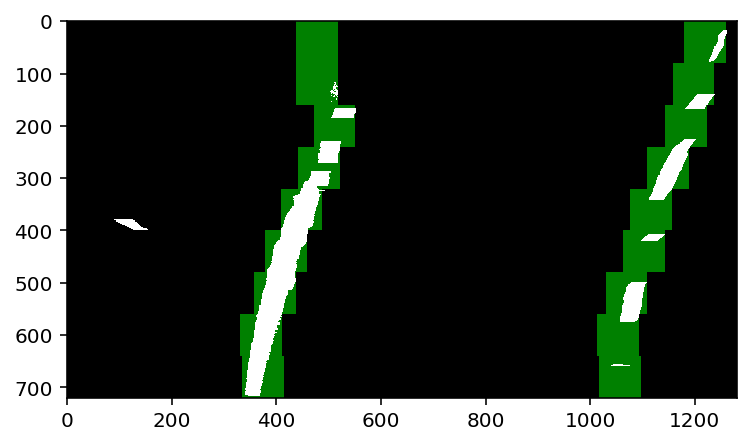

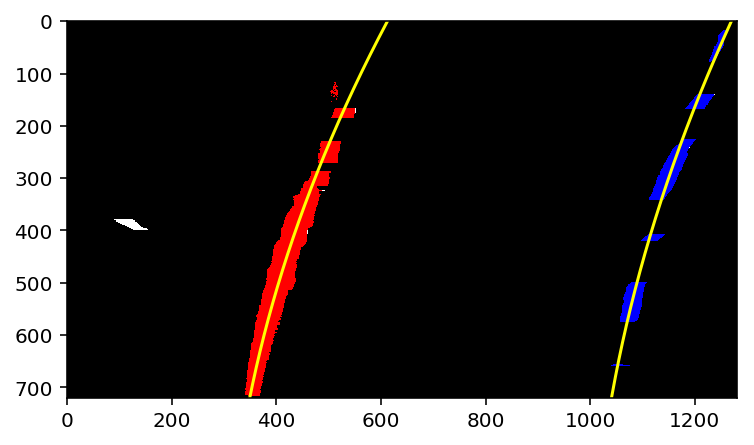

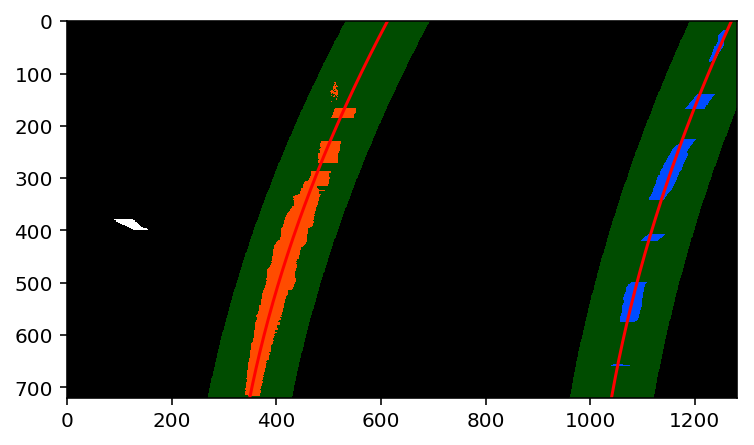

In [59]:
# Test lane pixel finding:
# window settings
window_width = 80 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 80 # How much to slide left and right for searching

images = glob.glob('test_images/*.jpg')
for img_path in images[:1]:
    img = mpimg.imread(img_path)
    undistorted = undistort(img)
    birds_eye = transform_perspective(undistorted)
    edge_masked = detect_edges(birds_eye)

    left_fit, right_fit = get_lane_polynomials(edge_masked, window_width, window_height, margin, visualize=True)
    plt.savefig("output_images/fitted_from_windows.png", bbox_inches="tight")
    plt.show()
    left_fit, right_fit = get_lane_polynomials_from_priors(edge_masked, window_width, window_height, margin, left_fit, right_fit, visualize=True)
    plt.savefig("output_images/fitted_from_prior_poly.png", bbox_inches="tight")
    plt.show()
    


In [60]:
class Params:
    def __init__(self):
        self.window_width = 80
        self.window_height =  80
        self.margin =  80
        self.frame_history = 5
        self.min_pixels = 2000
        
p = Params()

## Estimate Curve Radius and Lateral Position

In [75]:
def estimate_curve_radii(left_fit, right_fit, xm_per_pix, ym_per_pix, img_shape, y_eval=None):
    if y_eval is None: # Default to curve radius halfway out:
        y_eval = int(img_shape[0] / 4) 
    # Calculation of R_curve (radius of curvature)
    if left_fit is None:
        left_curverad = None
    else:
        left_curverad = ((1 + (2*left_fit[0]*y_eval*ym_per_pix + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    if right_fit is None:
        right_curverad = None
    else:
        right_curverad = ((1 + (2*right_fit[0]*y_eval*ym_per_pix + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    return left_curverad, right_curverad

def get_single_line_curve_type(fit, curve_rad, max_rad=4000):
    if curve_rad is None:
        return "unknown"
    elif curve_rad > max_rad:
        return "straight"
    elif is_left_curve(fit, curve_rad, max_rad=max_rad):
        return "left"
    elif is_right_curve(fit, curve_rad, max_rad=max_rad):
        return "right"
    else:
        return"unknown"

def is_left_curve(fitted_params, curve_rad, min_rad=100, max_rad=4000):
    return fitted_params[0] < 0 and fitted_params[1] > 0 and curve_rad < max_rad and curve_rad > min_rad

def is_right_curve(fitted_params, curve_rad, min_rad=100, max_rad=4000):
    return fitted_params[0] > 0 and fitted_params[1] < 0 and curve_rad < max_rad and curve_rad > min_rad

def get_curve_radius(left_fit, right_fit, img_shape):
    max_radius = 4000
    min_curve_ratio = 0.2
    max_curve_ratio = 5
    
    xm_per_pix, ym_per_pix = estimate_pixel_scale()
    left_curverad, right_curverad = estimate_curve_radii(left_fit, right_fit, xm_per_pix, ym_per_pix, img_shape, y_eval=None)
    
    if left_curverad is not None and right_curverad is not None:
        curve_ratio = left_curverad / right_curverad
        mean_radius = int((left_curverad + right_curverad) / 2)
        if mean_radius > max_radius:
            curve_type = "straight"
            curve_radius = np.inf
        elif curve_ratio < min_curve_ratio or curve_ratio > max_curve_ratio:
            curve_type = "unknown"
            curve_radius = 0
        elif is_left_curve(left_fit, left_curverad) and is_left_curve(right_fit, right_curverad):
            curve_type = "left"
            curve_radius = mean_radius
        elif is_right_curve(left_fit, left_curverad) and is_right_curve(right_fit, right_curverad):
            curve_type = "right"
            curve_radius = mean_radius
        else:
            curve_type = "unknown"
            curve_radius = 0
    else:
        curve_radius = 0
        curve_type = "unknown"
    return curve_radius, curve_type, left_curverad, right_curverad
    

def get_lateral_lane_pos(left_fit, right_fit, img_shape):
    xm_per_pix, ym_per_pix = estimate_pixel_scale()
    midpoint = xm_per_pix * img_shape[1] / 2

    y_eval = img_shape[0]
    if left_fit is not None:
        left_x = left_fit[0]*((ym_per_pix*y_eval)**2) + left_fit[1]*ym_per_pix*y_eval + left_fit[2]
    else:
        left_x = 0
    if right_fit is not None:
        right_x = right_fit[0]*((ym_per_pix*y_eval)**2) + right_fit[1]*ym_per_pix*y_eval + right_fit[2]
    else:
        right_x = 0
    
    lat_pos = get_lat_pos_from_line_x(left_x, right_x, img_shape)
    return lat_pos, left_x, right_x

def get_lat_pos_from_line_x(left_x, right_x, img_shape):
    xm_per_pix, ym_per_pix = estimate_pixel_scale()
    midpoint = xm_per_pix * img_shape[1] / 2
    lane_width = right_x - left_x
    lat_pos = midpoint - left_x - lane_width / 2
    return round(lat_pos, 2)

def get_radius_and_lat_pos(img, params):
    left_fit, right_fit = get_lane_polynomials(img, params.window_width, params.window_height, params.margin, visualize=False, rescale=True)
    curve_radius, curve_type, left_curverad, right_curverad = get_curve_radius(left_fit, right_fit, img.shape)
    lat_pos, left_x, right_x = get_lateral_lane_pos(left_fit, right_fit, img.shape)
    
    return curve_radius, curve_type, lat_pos
    

In [74]:
# Test curve radius and lateral position estimation:
images = glob.glob('test_images/*.jpg')
for img_path in images:
    img = mpimg.imread(img_path)
    undistorted = undistort(img)
    birds_eye = transform_perspective(undistorted)
    edge_masked = detect_edges(birds_eye)
    
    
    curve_radius, curve_type, lat_pos = get_radius_and_lat_pos(edge_masked, p)
    print(curve_radius, curve_type, lat_pos)

1064 right -0.31
644 right -0.06
780 right -0.37
598 right -0.26
806 right -0.18
506 left -0.43
inf straight -0.07
inf straight -0.05


## Draw Lane Overlay and Information

In [62]:
def draw_lane_overlay(original_img, edge_masked, left_fit, right_fit, params):
    #left_fit, right_fit = get_lane_polynomials(warped_img, params.window_width, params.window_height, params.margin, visualize=False, rescale=False)

    if left_fit is None or right_fit is None:
        return original_img
    
    ploty = np.linspace(0, edge_masked.shape[0]-1, edge_masked.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(edge_masked).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = inverse_perspective_transform(color_warp)
    #newwarp = cv2.warpPerspective(color_warp, Minv, (original_img.shape[1], original_img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(original_img, 1, newwarp, 0.3, 0)
    return result

def draw_curvature_info(img, frame_state):
    font                   = cv2.FONT_HERSHEY_SIMPLEX
    curve_position         = (20, 50)
    pos_position           = (20, 100)
    fontScale              = 1
    fontColor              = (255,255,255)
    lineType               = 2

    if frame_state.curve_type == "unknown":
        curve_string = "Unknown curvature"
    elif frame_state.curve_type == "straight":
        curve_string = "No curvature"
    else:
        curve_string = "{0} curve with {1} m radius".format(frame_state.curve_type.capitalize(), frame_state.curve_rad)
    pos_side = "left" if frame_state.lat_pos < 0 else "right"
    pos_string = "Lateral lane position: {0} m".format(frame_state.lat_pos)
    
    cv2.putText(img, curve_string, 
        curve_position, 
        font, 
        fontScale,
        fontColor,
        lineType)
    
    cv2.putText(img, pos_string, 
        pos_position, 
        font, 
        fontScale,
        fontColor,
        lineType)
    
    return img

## Time Filtering

In [23]:
from collections import deque
from copy import deepcopy

class Line:
    def __init__(self):
        self.x_pixels = np.array([])
        self.y_pixels = np.array([])
        self.fitted = None
        self.curve_rad = 0
        self.curve_type = "unknown"
        self.lat_pos = 0
        
    def __str__(self):
        return "Line with params: " + str(self.fitted)

class FrameState:
    def __init__(self, params, img_shape):
        self.p = params
        self.img_shape = img_shape
        self.curve_rad = 0
        self.curve_type = ""
        self.lat_pos = 0
        
        self.left_line = Line()
        self.right_line = Line()
        
        self.last_n_left = deque()
        self.last_n_right = deque()
      
    # Update the line deques holding past lines
    def update_line_memory(self, left_line, right_line):
        if not self.p.frame_history: # If filtering is turned off, just set our best guess to current frame estimate:
            self.left_line = left_line
            self.right_line = right_line
        else: # Otherwise, append the line estimates from this frame to our memory deque:
            self.last_n_left.append(left_line)
            self.last_n_right.append(right_line)
            # Remove too old line estimates:
            if len(self.last_n_left) > p.frame_history:
                self.last_n_left.popleft()
            if len(self.last_n_right) > p.frame_history:
                self.last_n_right.popleft()

    # Estimate the line estimations from the edge mask image
    def update_lines(self, edge_masked):
        left_line = Line()
        right_line = Line()
        
        left_undetected = len(self.last_n_left) == 0 or self.left_line.fitted is None
        right_undetected = len(self.last_n_right) == 0 or self.right_line.fitted is None
        
        # If we haven't detected lines from the last frame, we need to find the line pixels from scratch:
        if left_undetected or right_undetected:
            window_centroids = _find_window_centroids(edge_masked, self.p.window_width, self.p.window_height, self.p.margin)
            
        if left_undetected:
            left_line.x_pixels, left_line.y_pixels = get_nonzero_pixels_one_line(edge_masked, window_centroids, self.p.window_width, self.p.window_height, left_side=True)
        else:
            left_line.x_pixels, left_line.y_pixels = get_nonzero_pixels_from_priors_one_line(edge_masked, self.p.margin, self.left_line.fitted, left_side=True)

        if right_undetected:
            right_line.x_pixels, right_line.y_pixels = get_nonzero_pixels_one_line(edge_masked, window_centroids, self.p.window_width, self.p.window_height, left_side=False)
        else:
            right_line.x_pixels, right_line.y_pixels = get_nonzero_pixels_from_priors_one_line(edge_masked, self.p.margin, self.right_line.fitted, left_side=False)
       
        left_line.fitted, right_line.fitted, _ = fit_lane_polynomials(edge_masked, left_line.x_pixels, left_line.y_pixels, right_line.x_pixels, right_line.y_pixels)
        
        # Estimtate polynomials in real world distances istead of pixel distances.
        scaled_left_fit, scaled_right_fit, _ = fit_lane_polynomials(edge_masked, left_line.x_pixels, left_line.y_pixels, right_line.x_pixels, right_line.y_pixels, rescale=True)
        curve_radius, curve_type, left_line.curve_rad, right_line.curve_rad = get_curve_radius(scaled_left_fit, scaled_right_fit, edge_masked.shape)
        # Estimate wether lines are left, right, straight or unknown:
        left_line.curve_type = get_single_line_curve_type(scaled_left_fit, left_line.curve_rad)
        right_line.curve_type = get_single_line_curve_type(scaled_right_fit, right_line.curve_rad)
        
        lat_pos, left_line.lat_pos, right_line.lat_pos = get_lateral_lane_pos(scaled_left_fit, scaled_right_fit, edge_masked.shape)
        
        self.update_line_memory(left_line, right_line)

    # Average line polynomials over time:
    def _average_params(self, left):
        num_lines = 0

        if left:
            lines = self.last_n_left
            averaged_line = deepcopy(self.last_n_left[-1]) if len(self.last_n_left) else Line()
            inliers = self._get_inlier_indices(lines, self.right_line.curve_type)
        else:
            lines = self.last_n_right
            averaged_line = deepcopy(self.last_n_right[-1]) if len(self.last_n_right) else Line()
            inliers = self._get_inlier_indices(lines, self.left_line.curve_type)
           
        inlier_lines = np.array(lines)[inliers]
        if not len(inlier_lines):
            return Line()
        
        averaged_line.fitted = np.array([0, 0, 0], dtype='float64')
        averaged_line.curve_rad = 0
        averaged_line.lat_pos = 0
        
        for line in inlier_lines:
            if line.fitted is not None and len(line.x_pixels) > self.p.min_pixels:
                num_lines += 1
                averaged_line.fitted += line.fitted
                averaged_line.curve_rad += line.curve_rad
                averaged_line.lat_pos += line.lat_pos
                #print(line.lat_pos)
                
        if not num_lines:        
            return Line()
        
        averaged_line.fitted = np.divide(averaged_line.fitted, num_lines)
        averaged_line.curve_rad = np.divide(averaged_line.curve_rad, num_lines)
        averaged_line.lat_pos = np.divide(averaged_line.lat_pos, num_lines)
        
        return averaged_line
    
    # Get line indices for inliers based on history voting of turn direction and other side turn direction
    def _get_inlier_indices(self, lines, other_side_turn):
        num_lines = len(lines)
        turns = np.array([l.curve_type for l in lines])
        most_common = max(list(turns), key=list(turns).count)
        most_common_count = np.count_nonzero(turns == most_common)
                
        # If the other lines current estimate has the the same turn direction the voting limit is lowered:
        if other_side_turn != "unknown" and other_side_turn == most_common:
            sufficient_fraction = 0.2
        else:
            sufficient_fraction = 0.3
        
        #print(list(turns))

        if most_common != "unknown" and most_common_count / num_lines > sufficient_fraction:
            return np.where((turns == most_common) & (turns != "unknown"))[0]
        else:
            return np.where(turns != "unknown")[0] # Always filter out unknown line estimates
        
    def filter_lane_lines(self):
        if self.p.frame_history:
            self.left_line = self._average_params(left=True)
            self.right_line = self._average_params(left=False)
            
        if self.left_line.lat_pos is not None and self.right_line.lat_pos is not None:
            self.lat_pos = get_lat_pos_from_line_x(self.left_line.lat_pos, self.right_line.lat_pos, self.img_shape)
        else:
            self.lat_pos = 0.0
            
        if self.left_line.curve_rad is not None and self.right_line.curve_rad is not None:
            self.curve_rad = int((self.left_line.curve_rad + self.right_line.curve_rad) / 2.0)
        else:
            self.curve_rad = 0  
        
        self.curve_type = self.left_line.curve_type if self.left_line.curve_type is not None and self.left_line.curve_type == self.right_line.curve_type else "unknown"
        
        #scaled_left_fit, scaled_right_fit, _ = fit_lane_polynomials(edge_masked, self.left_line.x_pixels, self.left_line.y_pixels, self.right_line.x_pixels, self.right_line.y_pixels, rescale=True)
        #self.curve_radius, self.curve_type, self.left_line.curve_rad, self.right_line.curve_rad = get_curve_radius(scaled_left_fit, scaled_right_fit, self.img_shape)
        #self.lat_pos, self.left_line.lat_pos, self.right_line.lat_pos = get_lateral_lane_pos(scaled_left_fit, scaled_right_fit, self.img_shape)
        
        return self.left_line, self.right_line
    

## Image Pipeline

In [63]:
return_at = ""
p = Params()
p.frame_history = 0
p.min_pixels = 300

frame_state = FrameState(p, img.shape)

def process_frame(img):
    frame_state = FrameState(p, img.shape)
    undistorted = undistort(img)
    if return_at == "undistorted": return undistorted
    birds_eye = transform_perspective(undistorted, draw_polygon=False)
    #return draw_polygon_outline(undistorted)
    if return_at == "birds_eye": return birds_eye
    
    edge_masked = detect_edges(birds_eye)
    if return_at == "edge_masked": return np.dstack((edge_masked, edge_masked, edge_masked))*255
    
    frame_state.update_lines(edge_masked)
    left_line, right_line = frame_state.filter_lane_lines()
    
    lane_overlay = draw_lane_overlay(img, edge_masked, left_line.fitted, right_line.fitted, frame_state.p)
    text_overlay = draw_curvature_info(lane_overlay, frame_state)
    return lane_overlay

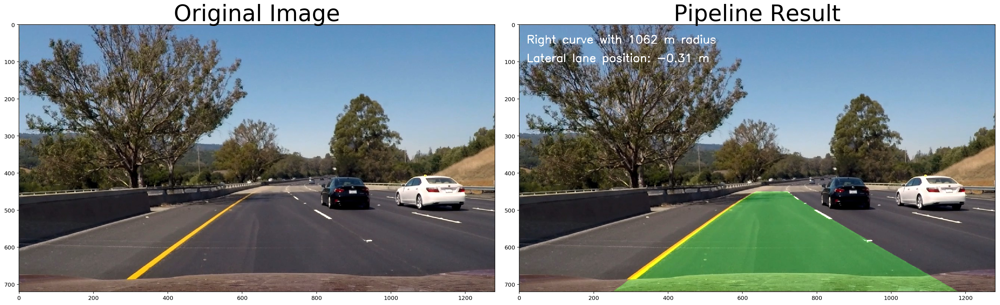

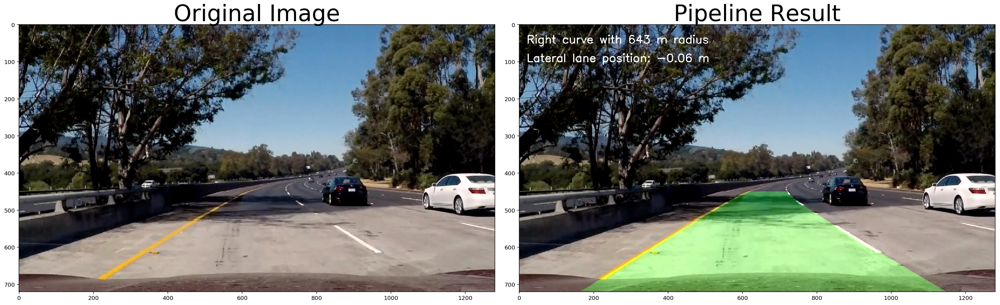

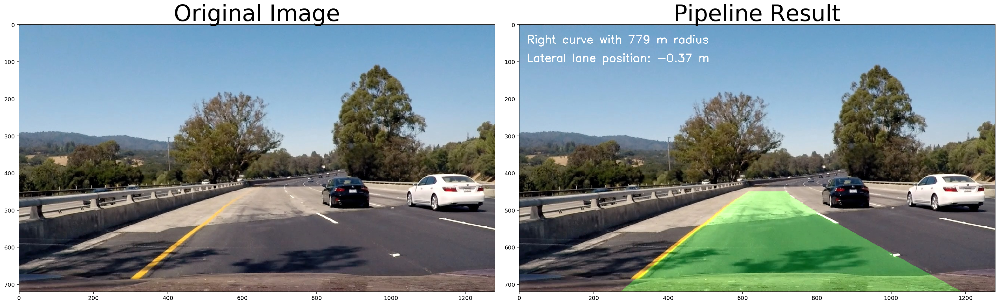

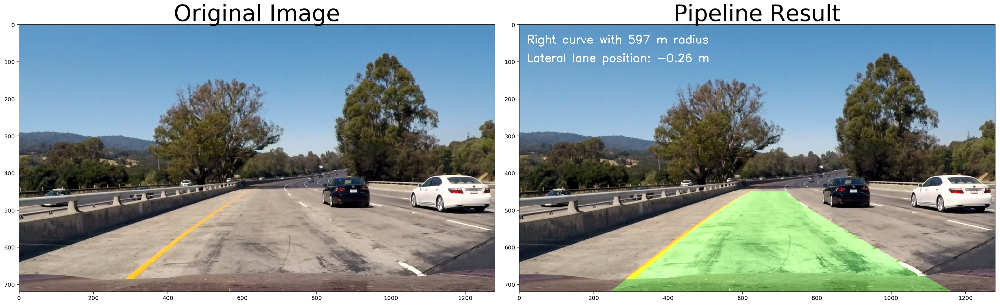

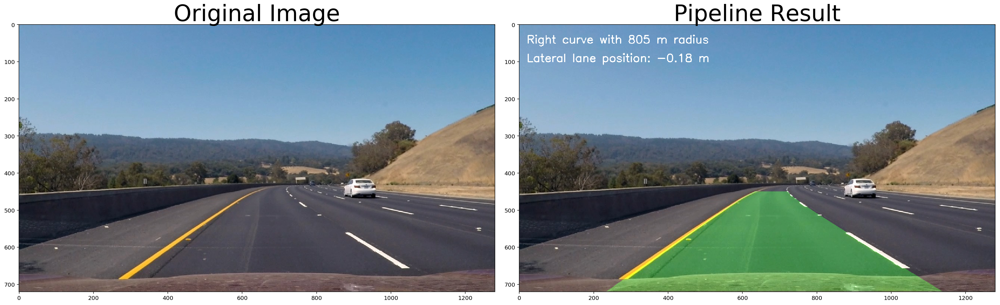

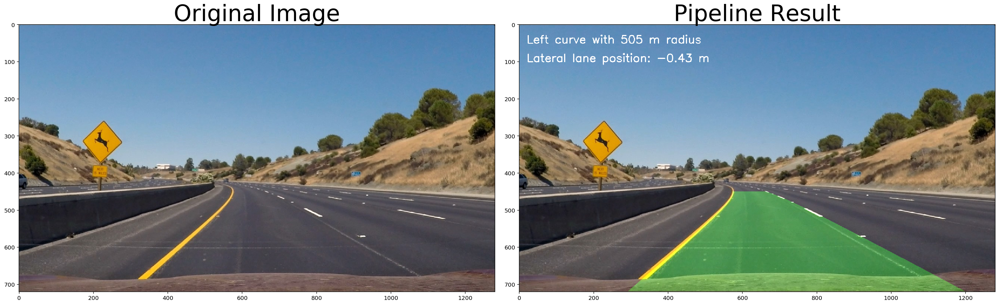

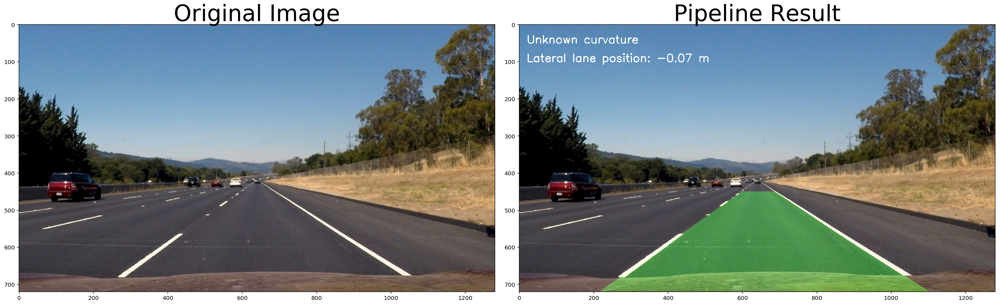

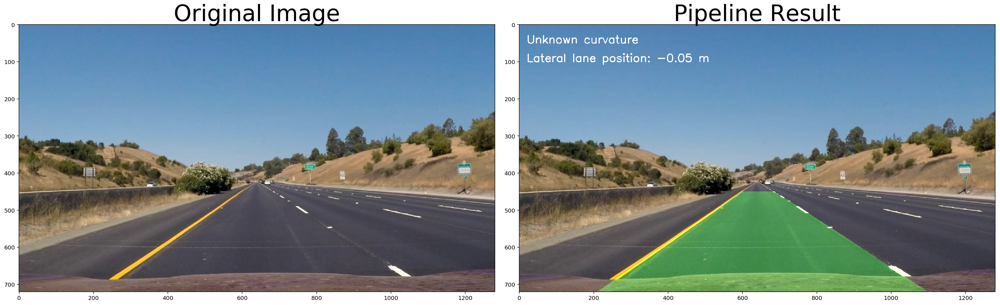

In [65]:
# Test pipeline
images = glob.glob('test_images/*.jpg')
for i, fname in enumerate(images):
    img = mpimg.imread(fname)
    result = process_frame(img)

    plot_side_by_side(img, result, "Original Image", "Pipeline Result", save_path1="output_images/lane_before{0}.jpg".format(i), save_path2="output_images/lane_after{0}.jpg".format(i))

In [26]:
video_input_path = 'project_video.mp4'

video_output_path = 'output_images/out_' + video_input_path

#clip = VideoFileClip(video_input_path).subclip(0,2)
clip = VideoFileClip(video_input_path)
output_clip = clip.fl_image(process_frame) #NOTE: this function expects color images!!
%time output_clip.write_videofile(video_output_path, audio=False)

[MoviePy] >>>> Building video output_images/out_project_video.mp4
[MoviePy] Writing video output_images/out_project_video.mp4



 12%|█▏        | 152/1261 [01:43<12:35,  1.47it/s]


 24%|██▍       | 303/1261 [03:25<10:43,  1.49it/s]


 36%|███▌      | 454/1261 [05:06<09:00,  1.49it/s]


 48%|████▊     | 605/1261 [06:47<07:18,  1.50it/s]


 60%|█████▉    | 756/1261 [08:28<05:47,  1.45it/s]


 72%|███████▏  | 907/1261 [10:11<04:01,  1.47it/s]


 84%|████████▍ | 1057/1261 [11:59<02:34,  1.32it/s]


 96%|█████████▌| 1205/1261 [13:50<00:38,  1.47it/s]


100%|█████████▉| 1260/1261 [14:27<00:00,  1.44it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/out_project_video.mp4 

CPU times: user 14min 58s, sys: 26.8 s, total: 15min 25s
Wall time: 14min 28s


In [27]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output_path))